# <span style="color:blue; font-weight:bold">FINAL PROJECT</span>

# 1.Importation

In [1]:
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
import warnings

warnings.filterwarnings(
    "ignore", category=DeprecationWarning
)  # to avoid deprecation warnings

In [2]:
path = "https://fullstackds-projects-bucket.s3.eu-west-3.amazonaws.com/data/glassdoor_reviews.csv"
dataset = pd.read_csv(path)
dataset_full = dataset.copy()

In [3]:
# Display the first few rows of the dataset to understand its structure
dataset.head()

,firm,date_review,job_title,current,location,overall_rating,work_life_balance,culture_values,diversity_inclusion,career_opp,comp_benefits,senior_mgmt,recommend,ceo_approv,outlook,headline,pros,cons
0,AFH-Wealth-Management,2015-04-05,,Current Employee,NaN,2,4.0,3.0,NaN,2.0,3.0,3.0,x,o,r,"Young colleagues, poor micro management",Very friendly and welcoming to new staff. Easy...,"Poor salaries, poor training and communication."
1,AFH-Wealth-Management,2015-12-11,Office Administrator,"Current Employee, more than 1 year","Bromsgrove, England, England",2,3.0,1.0,NaN,2.0,1.0,4.0,x,o,r,"Excellent staff, poor salary","Friendly, helpful and hard-working colleagues",Poor salary which doesn't improve much with pr...
2,AFH-Wealth-Management,2016-01-28,Office Administrator,"Current Employee, less than 1 year","Bromsgrove, England, England",1,1.0,1.0,NaN,1.0,1.0,1.0,x,o,x,"Low salary, bad micromanagement",Easy to get the job even without experience in...,"Very low salary, poor working conditions, very..."
3,AFH-Wealth-Management,2016-04-16,,Current Employee,NaN,5,2.0,3.0,NaN,2.0,2.0,3.0,x,o,r,Over promised under delivered,Nice staff to work with,No career progression and salary is poor
4,AFH-Wealth-Management,2016-04-23,Office Administrator,"Current Employee, more than 1 year","Bromsgrove, England, England",1,2.0,1.0,NaN,2.0,1.0,1.0,x,o,x,client reporting admin,"Easy to get the job, Nice colleagues.","Abysmal pay, around minimum wage. No actual tr..."


Les catégories v, r, x et o sont attribuées à la recommandation de l'entreprise ('recommend'), à l'approbation du PDG ('ceo_approv') et aux perspectives ('outlook'), avec les significations suivantes :
- v - positive,
- r - neutre,
- x - négative,
- o - sans opinion.

# 2. EDA

## 2.0 Exploration des données

In [4]:
# Information about the dataset
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 838566 entries, 0 to 838565
Data columns (total 18 columns):
 #   Column               Non-Null Count   Dtype  
---  ------               --------------   -----  
 0   firm                 838566 non-null  object 
 1   date_review          838566 non-null  object 
 2   job_title            838566 non-null  object 
 3   current              838566 non-null  object 
 4   location             541223 non-null  object 
 5   overall_rating       838566 non-null  int64  
 6   work_life_balance    688672 non-null  float64
 7   culture_values       647193 non-null  float64
 8   diversity_inclusion  136066 non-null  float64
 9   career_opp           691065 non-null  float64
 10  comp_benefits        688484 non-null  float64
 11  senior_mgmt          682690 non-null  float64
 12  recommend            838566 non-null  object 
 13  ceo_approv           838566 non-null  object 
 14  outlook              838566 non-null  object 
 15  headline         

<span style="color:black; font-weight:bold"> <u >Description of numerical categories </u></span>

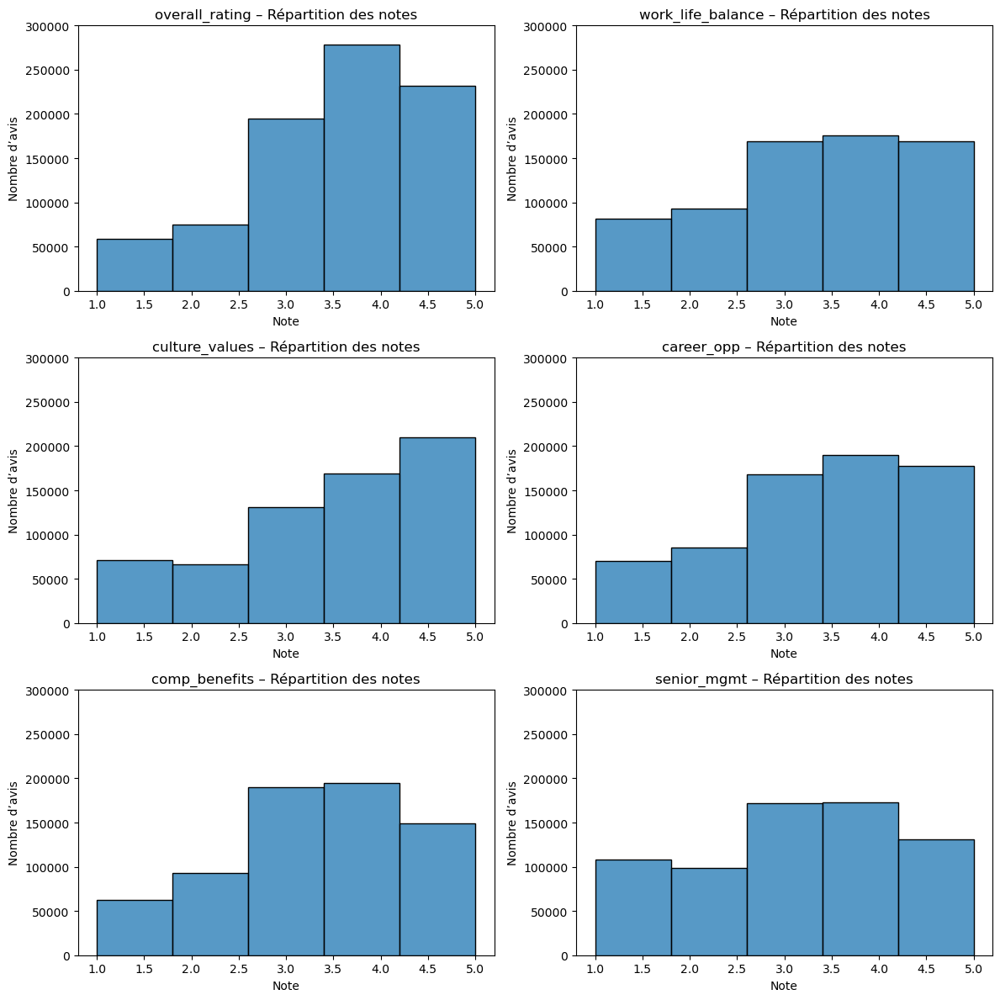

In [5]:
# Create func to plot notes distribution
def plot_distributions_grid(df, colonnes, max_y=300000):
    n = len(colonnes)
    lignes = (n + 1) // 2  # number of lines for 2 columns per line

    plt.figure(figsize=(12, 4 * lignes))

    for i, col in enumerate(colonnes, 1):
        plt.subplot(lignes, 2, i)
        sns.histplot(dataset[col], bins=5, kde=False)
        plt.title(f"{col} – Répartition des notes")
        plt.xlabel("Note")
        plt.ylabel("Nombre d’avis")
        plt.ylim(0, max_y)  # set up Y axis for all the plots

    plt.tight_layout()
    plt.show()
    
#list of notes columns
colonnes_notes = [
    'overall_rating',
    'work_life_balance',
    'culture_values',
    'career_opp',
    'comp_benefits',
    'senior_mgmt'
]

plot_distributions_grid(dataset, colonnes_notes)

- Work_life_balance et  senior_mgmt  ont plus d'important ratio de notes négatives que les autres
- Overall rating: note 4 prédomine
- Culture_values: la seule categorie où prédomine ta note maximale

<span style="color:black; font-weight:bold"> <u>Distribution of the coded categories -v - Positive, r - Mild, x - Negative, o - No opinion  </u></span>

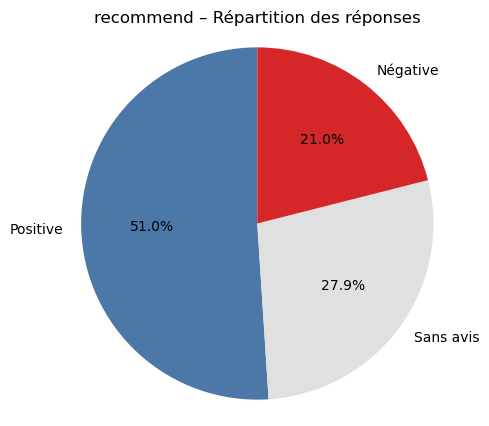

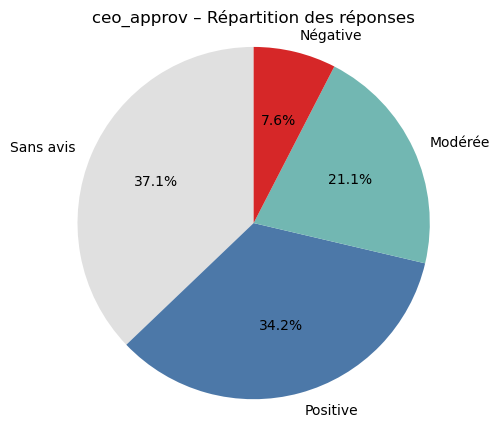

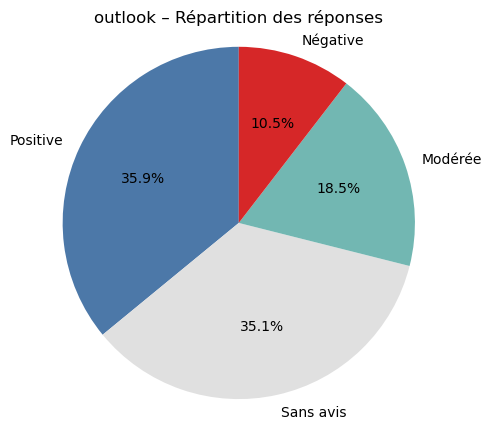

In [6]:
# Définition des labels et des couleurs associées
labels_map = {
    "v": "Positive",
    "r": "Modérée",
    "x": "Négative",
    "o": "Sans avis"
}

# Palette personnalisée : chaque label a sa propre couleur
colors_map = {
    "Positive": "#4C78A8",
    "Modérée": "#72B7B2",
    "Négative": "#D62728",
    "Sans avis": "#E0E0E0"
}

colonnes_cat = ["recommend", "ceo_approv", "outlook"]

# Pie charts
for col in colonnes_cat:
    valeurs = dataset[col].value_counts()
    labels = [labels_map[key] for key in valeurs.index]
    colors = [colors_map[label] for label in labels]

    plt.figure(figsize=(5, 5))
    plt.pie(
        valeurs,
        labels=labels,
        autopct="%1.1f%%",
        colors=colors,
        startangle=90
    )
    plt.title(f"{col} – Répartition des réponses")
    plt.axis("equal")
    plt.show()


<span style="color:black; font-weight:bold"> <u>Statistics and correlation</u></span>


Correlation between overall rating and recommend

In [7]:
# --- Corrélation recommend <-> overall_rating ---
# Transformation en score numérique
code_map = {"v": 2, "r": 1, "x": 0, "o": None}
dataset['recommend_score'] = dataset['recommend'].map(code_map)

# Corrélation (sans NaN)
corr = dataset[['overall_rating', 'recommend_score']].dropna().corr().iloc[0, 1]
print(f"\nCorrélation entre overall_rating et recommend_score : {corr:.3f}")



Corrélation entre overall_rating et recommend_score : 0.731


Corrélation entre overall_rating et recommend_score : 0.731

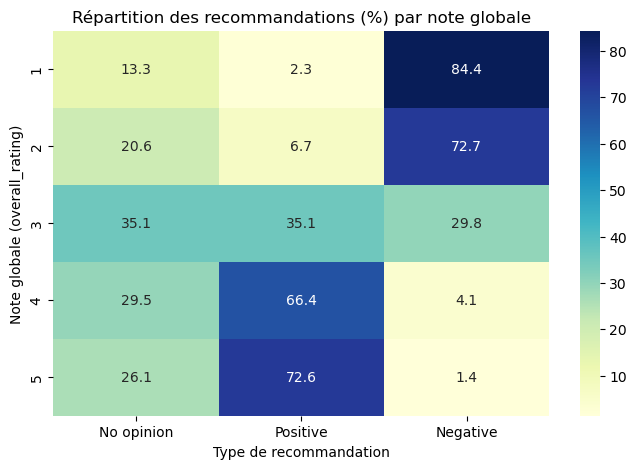

In [8]:
# Création de la table normalisée
table_pct = pd.crosstab(dataset['overall_rating'], dataset['recommend'], normalize='index') * 100

# Renommer les colonnes pour plus de clarté
table_pct = table_pct.rename(columns={
    "v": "Positive",
    "r": "Mild",
    "x": "Negative",
    "o": "No opinion"
})

# Affichage de la heatmap
plt.figure(figsize=(8, 5))
sns.heatmap(table_pct, annot=True, fmt=".1f", cmap="YlGnBu")
plt.title("Répartition des recommandations (%) par note globale")
plt.xlabel("Type de recommandation")
plt.ylabel("Note globale (overall_rating)")
plt.show()

La heatmap confirme ce qu’on peut supposer intuitivement – les recommandations sont bien corrélées avec les notes globales. Ca veut dire que la donnée est cohérente (pas de gros bruit ou erreur de labellisation)

## 2.1 Preprocessing des données

La première étape consiste à nettoyer le dataset des données (feature ou entrée) n'ayant pas d'intérêt pour la résolution de notre problème.

### 2.1.1 Diminution du dataset

In [9]:
# Display the total number of rows in the dataset
total_length = len(dataset)
print(f"Total length of the dataset: {total_length}")

Total length of the dataset: 838566


In [10]:
# Check for missing values in the dataset
missing_values = dataset.isnull().sum()
print("Nombres de valeurs manquantes:\n", total_length - missing_values[missing_values > 0])
print()
percentage = (missing_values / total_length) * 100
print(f"Pourcentage de valeurs manquantes:\n{percentage[missing_values > 0].sort_values(ascending=False)}")

Nombres de valeurs manquantes:
 location               541223
work_life_balance      688672
culture_values         647193
diversity_inclusion    136066
career_opp             691065
comp_benefits          688484
senior_mgmt            682690
headline               835976
pros                   838564
cons                   838553
recommend_score        604318
dtype: int64

Pourcentage de valeurs manquantes:
diversity_inclusion    83.773967
location               35.458509
recommend_score        27.934355
culture_values         22.821459
senior_mgmt            18.588400
comp_benefits          17.897458
work_life_balance      17.875039
career_opp             17.589671
headline                0.308861
cons                    0.001550
pros                    0.000239
dtype: float64


Avec 83% de données manquantes, on supprime la feature "diversity_inclusion"

In [11]:
# Drop de diversity_inclusion
dataset.drop(columns=["diversity_inclusion"], inplace=True)

In [12]:
# Isolation des entreprises dans une variable
df_firm = dataset["firm"].reset_index(drop=True)
firm_count = df_firm.value_counts()

# Nombre de firmes
print(f"Nombre de firmes initiales: {len(firm_count)}")
print(f"Nombre de reviews initiales: {firm_count.sum()}")

# Filtrage sur le nombre de reviews
for review in [10, 100, 500, 1000, 5000]:
    print("******************")
    print(f"Nombre de firmes avec au moins {review} reviews: {len(firm_count[firm_count >= review])}")
    count = firm_count[firm_count >= review].sum()
    print(f"Nombre de lignes restantes après application du filtre: {count}")
    print(f"Pourcentage de reviews restantes: {count / firm_count.sum() * 100:.2f}%")
    


Nombre de firmes initiales: 428
Nombre de reviews initiales: 838566
******************
Nombre de firmes avec au moins 10 reviews: 417
Nombre de lignes restantes après application du filtre: 838511
Pourcentage de reviews restantes: 99.99%
******************
Nombre de firmes avec au moins 100 reviews: 332
Nombre de lignes restantes après application du filtre: 833773
Pourcentage de reviews restantes: 99.43%
******************
Nombre de firmes avec au moins 500 reviews: 165
Nombre de lignes restantes après application du filtre: 792390
Pourcentage de reviews restantes: 94.49%
******************
Nombre de firmes avec au moins 1000 reviews: 111
Nombre de lignes restantes après application du filtre: 754696
Pourcentage de reviews restantes: 90.00%
******************
Nombre de firmes avec au moins 5000 reviews: 33
Nombre de lignes restantes après application du filtre: 562471
Pourcentage de reviews restantes: 67.08%


Nous pouvons observer que limiter le dataset aux entreprises ayant un nombre minimal de review permet de réduire le dataset. Nous décidons par conséquent d'apporter un filtre directement sur le nombre d'entreprise sur lequel basé notre étude.

In [13]:
for top_nb in [33, 30, 20, 10]:
# Top X firmes avec le plus de reviews
# top_nb = 10
    top_firmes = firm_count.nlargest(top_nb)
    top_firmes_normalised = 100 * top_firmes/top_firmes.max()

    # J'ai normalisé les reviews pour comparer les firmes entre elles
    fig = px.histogram(top_firmes, x=top_firmes.index, y=top_firmes.values)
    fig.update_layout(
        title=f"Top {top_nb} firmes avec le plus de reviews -- {top_firmes.sum()} reviews",
        xaxis_title="Firme",
        yaxis_title="Nombres de reviews",
        xaxis_tickangle=-45,
    )
    fig.show()

    # fig = px.histogram(top_firmes_normalised, x=top_firmes_normalised.index, y=top_firmes_normalised.values)
    # fig.update_layout(
    #     title=f"Top {top_nb} firmes avec le plus de reviews",
    #     xaxis_title="Firme",
    #     yaxis_title="Pourcentages de reviews (%) normalisés",
    #     xaxis_tickangle=-45,
    # )
    # fig.show()

Nous décidons de limiter au 10 firmes ayant le plus de review.

In [14]:
dataset_limited = dataset[dataset["firm"].isin(top_firmes.index.to_list())].reset_index(drop=True)

In [15]:
dataset_limited.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354200 entries, 0 to 354199
Data columns (total 18 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   firm               354200 non-null  object 
 1   date_review        354200 non-null  object 
 2   job_title          354200 non-null  object 
 3   current            354200 non-null  object 
 4   location           223322 non-null  object 
 5   overall_rating     354200 non-null  int64  
 6   work_life_balance  286755 non-null  float64
 7   culture_values     264561 non-null  float64
 8   career_opp         287903 non-null  float64
 9   comp_benefits      286923 non-null  float64
 10  senior_mgmt        284307 non-null  float64
 11  recommend          354200 non-null  object 
 12  ceo_approv         354200 non-null  object 
 13  outlook            354200 non-null  object 
 14  headline           352907 non-null  object 
 15  pros               354200 non-null  object 
 16  co

In [16]:
dataset = dataset_limited.copy()

En analysant les données directement, nous décidons de supprimer les features "Job_title" et "location"

In [17]:
dataset.drop(columns=["job_title"], inplace=True)
dataset.drop(columns=["location"], inplace=True)

### 2.1.2 Traitement des valeurs manquantes

In [18]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354200 entries, 0 to 354199
Data columns (total 16 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   firm               354200 non-null  object 
 1   date_review        354200 non-null  object 
 2   current            354200 non-null  object 
 3   overall_rating     354200 non-null  int64  
 4   work_life_balance  286755 non-null  float64
 5   culture_values     264561 non-null  float64
 6   career_opp         287903 non-null  float64
 7   comp_benefits      286923 non-null  float64
 8   senior_mgmt        284307 non-null  float64
 9   recommend          354200 non-null  object 
 10  ceo_approv         354200 non-null  object 
 11  outlook            354200 non-null  object 
 12  headline           352907 non-null  object 
 13  pros               354200 non-null  object 
 14  cons               354197 non-null  object 
 15  recommend_score    244964 non-null  float64
dtypes:

In [19]:
# Check for missing values in the limited dataset
missing_values = dataset.isnull().sum()
print("Nombres de valeurs manquantes:\n", total_length - missing_values[missing_values > 0])
print()
percentage = (missing_values / total_length) * 100
print(f"Pourcentage de valeurs manquantes:\n{percentage[missing_values > 0].sort_values(ascending=False)}")




Nombres de valeurs manquantes:
 work_life_balance    771121
culture_values       748927
career_opp           772269
comp_benefits        771289
senior_mgmt          768673
headline             837273
cons                 838563
recommend_score      729330
dtype: int64

Pourcentage de valeurs manquantes:
recommend_score      13.026524
culture_values       10.689558
senior_mgmt           8.334824
work_life_balance     8.042897
comp_benefits         8.022863
career_opp            7.905997
headline              0.154192
cons                  0.000358
dtype: float64


<span style="color:black; font-weight:bold"> <u>Cas n°1: Drop des valeurs</u></span>


In [20]:
dataset_drop = dataset.copy()
list_numerical = dataset.select_dtypes(include=[np.number]).columns.tolist()
# list_categorical = dataset.select_dtypes(include=[np.object_]).columns.tolist()

# Drop des erreurs manquantes
for feature in list_numerical:
    dataset_drop = dataset_drop.dropna(subset=feature, how="all")
dataset_drop.reset_index(drop=True, inplace=True)

dataset_drop.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 219079 entries, 0 to 219078
Data columns (total 16 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   firm               219079 non-null  object 
 1   date_review        219079 non-null  object 
 2   current            219079 non-null  object 
 3   overall_rating     219079 non-null  int64  
 4   work_life_balance  219079 non-null  float64
 5   culture_values     219079 non-null  float64
 6   career_opp         219079 non-null  float64
 7   comp_benefits      219079 non-null  float64
 8   senior_mgmt        219079 non-null  float64
 9   recommend          219079 non-null  object 
 10  ceo_approv         219079 non-null  object 
 11  outlook            219079 non-null  object 
 12  headline           218588 non-null  object 
 13  pros               219079 non-null  object 
 14  cons               219076 non-null  object 
 15  recommend_score    219079 non-null  float64
dtypes:

En appliquant le drop des valeurs manquantes, nous passons de 354200 entrées à 260873 entrées. Cela représente une perte de 27% des données du dataset limité. Nous considérons que la perte est trop importante.

<span style="color:black; font-weight:bold"> <u>Cas n°2: Remplacement des valeurs manquantes par la MEDIANE</u></span>


Nous décidons d'appliquer un remplacement par la valeur médiane, la valeur moyenne n'ayant pas de cohérence. Nous appliquons par la même occasion un filtre pour que la valeur médiance soit calculée par entreprise.

In [21]:
# Remplacement des valeurs manquantes par la valeur médiane pour chaque entreprise
dataset_replacement = dataset.copy()
for feature in list_numerical:
    dataset_replacement[feature] = dataset_replacement.groupby("firm")[feature].transform(lambda df: df.fillna(df.median()))

dataset_replacement.reset_index(drop=True, inplace=True)

dataset_replacement.info()
dataset = dataset_replacement.copy()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354200 entries, 0 to 354199
Data columns (total 16 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   firm               354200 non-null  object 
 1   date_review        354200 non-null  object 
 2   current            354200 non-null  object 
 3   overall_rating     354200 non-null  int64  
 4   work_life_balance  354200 non-null  float64
 5   culture_values     354200 non-null  float64
 6   career_opp         354200 non-null  float64
 7   comp_benefits      354200 non-null  float64
 8   senior_mgmt        354200 non-null  float64
 9   recommend          354200 non-null  object 
 10  ceo_approv         354200 non-null  object 
 11  outlook            354200 non-null  object 
 12  headline           352907 non-null  object 
 13  pros               354200 non-null  object 
 14  cons               354197 non-null  object 
 15  recommend_score    354200 non-null  float64
dtypes:

### 2.1.3 Champs textes

Nous décidons de conserver les entrées vides concernant les features "Headline","Pros" et "Cons" dans la mesure où ces entrées n'auront pas d'influence sur les résultats finaux (ex: la tokenisation n'apportera pas de token sur du vide).

### 2.2.4 Data engineering 

In [22]:
def categorize_experience(string_value):
    if 'less than 1 year' in string_value.lower():
        return 'Junior'
    elif 'more than 1 year' in string_value.lower():
        return 'Junior'
    elif 'more than 3 year' in string_value.lower():
        return 'Junior'
    elif 'more than 5 year' in string_value.lower():
        return 'Confirmed'
    elif 'more than 8 year' in string_value.lower():
        return 'Senior'
    elif 'more than 10 year' in string_value.lower():
        return 'Senior'
    else:
        return 'No information'

def categorize_job(string_value):
    if 'employee' in string_value.lower():
        return 'employee'
    elif 'contractor' in string_value.lower():
        return 'contractor'
    elif 'intern' in string_value.lower():
        return 'intern'
    elif 'temporary' in string_value.lower():
        return 'temporary'
    elif 'freelancer' in string_value.lower():
        return 'freelancer'
    else:
        return np.nan
    
def categorize_current(string_value):
    if 'current' in string_value.lower():
        return 'current'
    elif 'former' in string_value.lower():
        return 'former'
    else:
        return np.nan

In [23]:
dataset.head(2)

,firm,date_review,current,overall_rating,work_life_balance,culture_values,career_opp,comp_benefits,senior_mgmt,recommend,ceo_approv,outlook,headline,pros,cons,recommend_score
0,Apple,2008-01-31,Current Employee,5,3.0,5.0,3.0,4.0,4.0,v,v,o,We make products that poeple enjoy buying and ...,The people we work with are great and I can't ...,You have to be careful because this job can ta...,2.0
1,Apple,2008-02-14,Current Employee,4,4.0,5.0,3.0,4.0,3.0,v,v,o,It is a different job because of all of the di...,The big positive for me is that I really do en...,I suppose that a con would be that there is a ...,2.0


In [24]:
# Application des fonctions de catégorisation
dataset["status"] = dataset["current"].apply(categorize_current)
dataset["job"] = dataset["current"].apply(categorize_job)
dataset["experience"] = dataset["current"].apply(categorize_experience)

# Suppression de la colonne "current" car elle est corélée avec les trois colonnes créees
dataset.drop(columns=["current"], inplace=True)


In [25]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 354200 entries, 0 to 354199
Data columns (total 18 columns):
 #   Column             Non-Null Count   Dtype  
---  ------             --------------   -----  
 0   firm               354200 non-null  object 
 1   date_review        354200 non-null  object 
 2   overall_rating     354200 non-null  int64  
 3   work_life_balance  354200 non-null  float64
 4   culture_values     354200 non-null  float64
 5   career_opp         354200 non-null  float64
 6   comp_benefits      354200 non-null  float64
 7   senior_mgmt        354200 non-null  float64
 8   recommend          354200 non-null  object 
 9   ceo_approv         354200 non-null  object 
 10  outlook            354200 non-null  object 
 11  headline           352907 non-null  object 
 12  pros               354200 non-null  object 
 13  cons               354197 non-null  object 
 14  recommend_score    354200 non-null  float64
 15  status             354200 non-null  object 
 16  jo

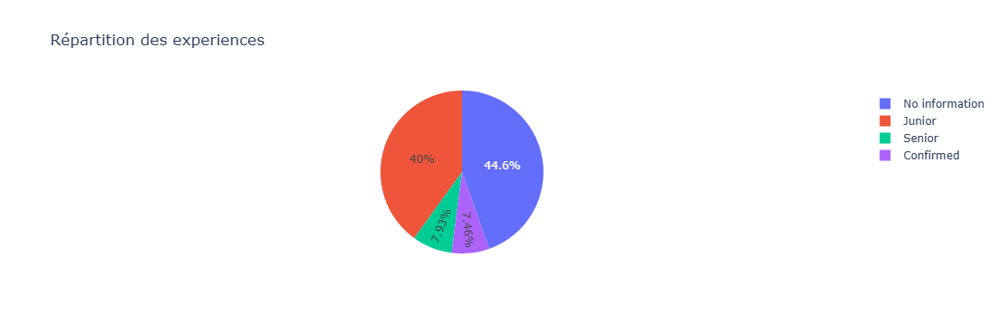

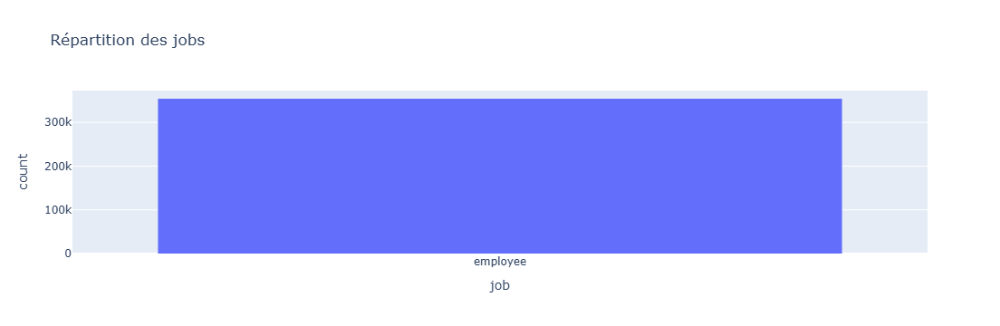

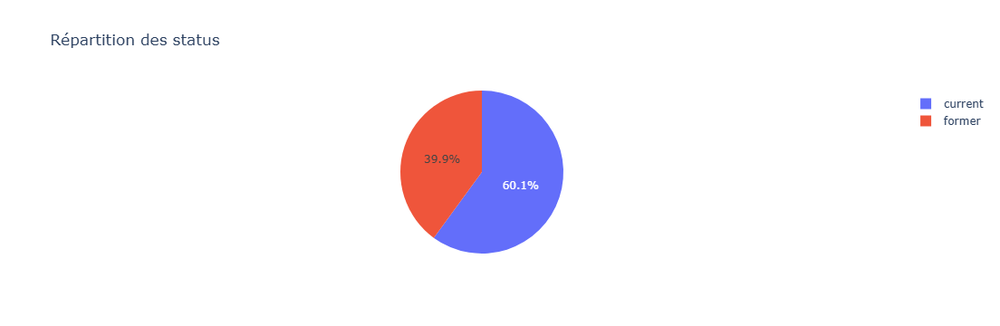

In [26]:
fig = px.pie(dataset, names='experience', title='Répartition des experiences')
fig.show()

fig = px.histogram(dataset, x = dataset['job'], title='Répartition des jobs')
fig.show()

fig = px.pie(dataset, names = dataset['status'], title='Répartition des status')
fig.show()

Les graphes montrent que nous pouvons supprimer la colonne job car elle ne présente que des "employees".

In [27]:
dataset["job"].value_counts()

job
employee    354200
Name: count, dtype: int64

In [28]:
dataset.drop(columns=["job"], inplace=True)

In [29]:
#pip install s3fs

   ---------------------------------------- 0.0/13.3 MB ? eta -:--:--
   ---------------------------------------  13.1/13.3 MB 117.8 MB/s eta 0:00:01
   ---------------------------------------  13.1/13.3 MB 117.8 MB/s eta 0:00:01
   ---------------------------------------- 13.3/13.3 MB 32.2 MB/s eta 0:00:00

   ----------------------------------------  0/15 [wrapt]
   ----------------------------------------  0/15 [wrapt]
   ----- ----------------------------------  2/15 [multidict]
   -------- -------------------------------  3/15 [jmespath]
   ---------- -----------------------------  4/15 [fsspec]
   ---------- -----------------------------  4/15 [fsspec]
   ---------- -----------------------------  4/15 [fsspec]
   ------------- --------------------------  5/15 [frozenlist]
   ------------- --------------------------  5/15 [frozenlist]
   ---------------- -----------------------  6/15 [async-timeout]
   ------------------ ---------------------  7/15 [aioitertools]
   --------------

In [34]:
# Sauvegarde du dataset sous forme de CSV
#dataset.to_csv("s3://fullstackds-projects-bucket/data/glassdoor_reviews_cleaned.csv", index=False)

#### Conclusion: 
Le dataset initial comptait plus de 800 000 observations, ce qui le rendait trop volumineux pour une analyse NLP et l’entraînement de modèles de classification sur des données textuelles.

Pour rendre l’analyse NLP et l’entraînement des modèles plus gérables, nous avons évalué différentes stratégies de filtrage selon le nombre minimum de reviews par entreprise. 

La décision finale a été de se concentrer sur les 10 entreprises ayant le plus grand nombre de reviews (au moins 5000 chacune), ce qui représente environ 67% du volume total.

Ce choix présente plusieurs avantages : un grand volume de données par entreprise, une meilleure stabilité des thèmes exprimés, et une analyse plus fluide. 

Cependant, ce filtrage introduit aussi un **biais potentiel**, car ces entreprises sont souvent les plus grandes et les plus visibles sur la plateforme. Les résultats obtenus ne sont donc pas forcément généralisables à toutes les entreprises du marché.